In [3]:
# Import Data Science libraries
import pandas as pd
import numpy as np
from scipy.stats import linregress

# Import Data Visualization
import matplotlib.pyplot as plt
import seaborn as sns



In [4]:
# Load the CSV  
Countries_AQI_datapath = 'AQI and Lat Long of Countries.csv'

# Read the CSV file into a pandas DataFrame
Countries_AQI = pd.read_csv(Countries_AQI_datapath)

# Load the CSV containing country-to-continent mappings
continent_mapping_datapath = 'Countries by continents.csv'

# Read the CSV file into a pandas DataFrame
continent_mapping_data = pd.read_csv(continent_mapping_datapath)


In [5]:
# Display the Countries data 
#Countries_AQI.to_csv('output.csv')

In [6]:
# Reset index after dropping rows
Countries_AQI_data=Countries_AQI.dropna(subset=['Country'])
Countries_AQI_data.info()


<class 'pandas.core.frame.DataFrame'>
Index: 16393 entries, 0 to 16694
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Country             16393 non-null  object 
 1   City                16393 non-null  object 
 2   AQI Value           16393 non-null  int64  
 3   AQI Category        16393 non-null  object 
 4   CO AQI Value        16393 non-null  int64  
 5   CO AQI Category     16393 non-null  object 
 6   Ozone AQI Value     16393 non-null  int64  
 7   Ozone AQI Category  16393 non-null  object 
 8   NO2 AQI Value       16393 non-null  int64  
 9   NO2 AQI Category    16393 non-null  object 
 10  PM2.5 AQI Value     16393 non-null  int64  
 11  PM2.5 AQI Category  16393 non-null  object 
 12  lat                 16393 non-null  float64
 13  lng                 16393 non-null  float64
dtypes: float64(2), int64(5), object(7)
memory usage: 1.9+ MB


In [8]:
duplicates_AQI_data = Countries_AQI_data[Countries_AQI_data.duplicated(subset=['Country', 'City'])]

In [13]:
# Dropping Duplicates
AQI_data_cleaned = Countries_AQI_data.drop_duplicates(subset=['Country', 'City'], keep='first')

In [15]:
AQI_data_cleaned = AQI_data_cleaned.rename(columns={

                                            'AQI Value':'Air_Quality_Value', 
                                            'AQI Category':'Air_Quality_Category',
                                            'CO AQI Value':'CO_AQI_Value',
                                            'CO AQI Category':'CO_AQI_Category', 
                                            'Ozone AQI Value':'Ozone_AQI_Value', 
                                            'Ozone AQI Category':'Ozone_AQI_Category',
                                            'NO2 AQI Value':'NO2_AQI_Value',
                                            'NO2 AQI Category':'NO2_AQI_Category', 
                                            'PM2.5 AQI Value':'PM2.5_AQI_Value', 
                                            'PM2.5 AQI Category':'PM2.5_AQI_Category', 
                                            'lat': 'Latitude',
                                            'lng': 'Longitude'
})

In [17]:
print(AQI_data_cleaned.shape)
AQI_data_cleaned.info()

(13956, 14)
<class 'pandas.core.frame.DataFrame'>
Index: 13956 entries, 0 to 16694
Data columns (total 14 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Country               13956 non-null  object 
 1   City                  13956 non-null  object 
 2   Air_Quality_Value     13956 non-null  int64  
 3   Air_Quality_Category  13956 non-null  object 
 4   CO_AQI_Value          13956 non-null  int64  
 5   CO_AQI_Category       13956 non-null  object 
 6   Ozone_AQI_Value       13956 non-null  int64  
 7   Ozone_AQI_Category    13956 non-null  object 
 8   NO2_AQI_Value         13956 non-null  int64  
 9   NO2_AQI_Category      13956 non-null  object 
 10  PM2.5_AQI_Value       13956 non-null  int64  
 11  PM2.5_AQI_Category    13956 non-null  object 
 12  Latitude              13956 non-null  float64
 13  Longitude             13956 non-null  float64
dtypes: float64(2), int64(5), object(7)
memory usage: 1.6+ MB


In [19]:
# Dictionary for standardizing country names
standard_country_names = {
    'United States of America': 'United States',
    'Russian Federation': 'Russia',
    'United Kingdom of Great Britain and Northern Ireland':'United Kingdom',
    'Viet Nam': 'Vietnam',
    'Myanmar':'Burma (Myanmar)',
    'United Republic of Tanzania':'Tanzania',
    'Democratic Republic of the Congo':'Congo',
    'Bolivia (Plurinational State of)':'Bolivia',
    'Venezuela (Bolivarian Republic of)':'Venezuela',
    'Burkina Faso':'Burkina', 
    "Côte d'Ivoire" : 'Ivory Coast',
    'Iran (Islamic Republic of)' : 'Iran',
    'Cabo Verde' : 'Cape Verde',
    'Republic of North Macedonia' : 'Macedonia',
    'North Macedonia' : 'Macedonia',
    'Republic of Moldova' : 'Moldova',
    "Lao People's Democratic Republic" : 'Laos',
    'State of Palestine' : 'Palestine',
    'Syrian Arab Republic' : 'Syria',
    'Kingdom of Eswatini' :'Swaziland',
    'Eswatini' :'Swaziland', 
    'Republic of Korea':'South Korea', 
    'Aruba' : 'Aruba', 
    'State of Palestine': 'Palestine',
    'Palestine': 'Palestine'
    # Add more mappings if needed
}

# Apply the mapping to both DataFrames to standardize country names
AQI_data_cleaned['Country'] = AQI_data_cleaned['Country'].map(standard_country_names).fillna(AQI_data_cleaned['Country'])



In [21]:
cities_continents_merged = AQI_data_cleaned.merge(continent_mapping_data, on='Country', how='left')
cities_continents_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13956 entries, 0 to 13955
Data columns (total 15 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Country               13956 non-null  object 
 1   City                  13956 non-null  object 
 2   Air_Quality_Value     13956 non-null  int64  
 3   Air_Quality_Category  13956 non-null  object 
 4   CO_AQI_Value          13956 non-null  int64  
 5   CO_AQI_Category       13956 non-null  object 
 6   Ozone_AQI_Value       13956 non-null  int64  
 7   Ozone_AQI_Category    13956 non-null  object 
 8   NO2_AQI_Value         13956 non-null  int64  
 9   NO2_AQI_Category      13956 non-null  object 
 10  PM2.5_AQI_Value       13956 non-null  int64  
 11  PM2.5_AQI_Category    13956 non-null  object 
 12  Latitude              13956 non-null  float64
 13  Longitude             13956 non-null  float64
 14  Continent             13954 non-null  object 
dtypes: float64(2), int6

In [26]:
cities_continents_merged.to_csv("out.csv")

In [28]:
cities_continents_merged["Country"].nunique()

173

In [30]:
# Group by Country and calculate the average AQI
country_aqi = cities_continents_merged.groupby('Country')['Air_Quality_Value'].mean().reset_index()

#Sort the countries by average AQI in descending order
country_aqi_sorted = country_aqi.sort_values(by='Air_Quality_Value', ascending=False)

#Select only the top 50 countries
top_20_countries = country_aqi_sorted.head(20)


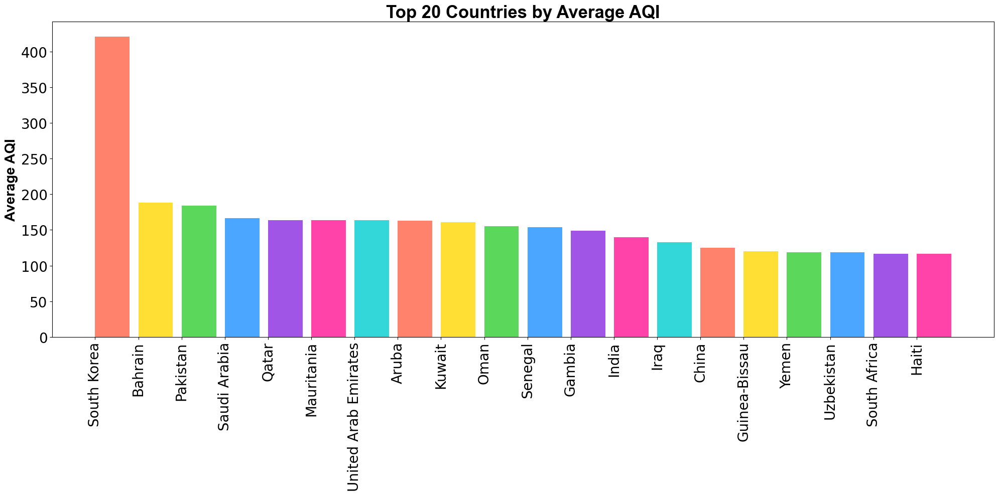

In [32]:
plt.figure(figsize=(20, 10)) 

# Set colors 
colors = ['#FF6347', '#FFD700', '#32CD32', '#1E90FF', '#8A2BE2', '#FF1493', '#00CED1']

# Plot the bar chart
plt.bar(top_20_countries['Country'], top_20_countries['Air_Quality_Value'], color=colors, alpha=0.8, align="edge")

# Labels and title
plt.ylabel('Average AQI', fontweight="bold", fontsize=20, fontfamily="Arial")

plt.title('Top 20 Countries by Average AQI', fontweight="bold", fontsize=25, fontfamily="Arial")

# Adjust the tick positions and rotate labels
plt.xticks(top_20_countries['Country'], rotation="vertical", fontsize=20)
plt.yticks(fontsize=20)

plt.tight_layout()

# Show the plot
plt.show()


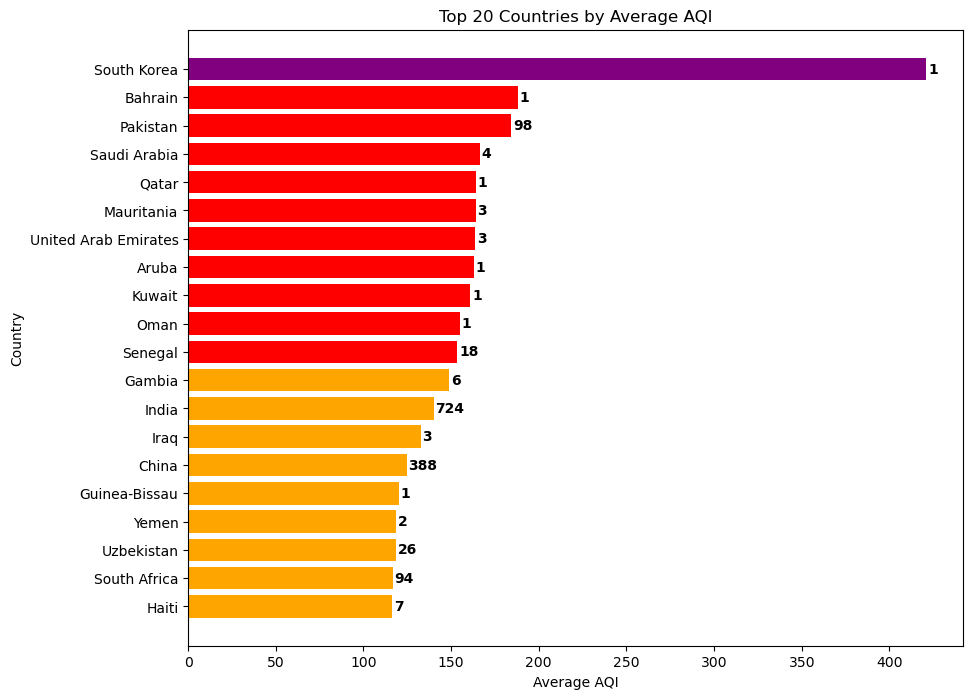

In [34]:
# 1. Group by 'Country' and calculate the average AQI
country_aqi = cities_continents_merged.groupby('Country')['Air_Quality_Value'].mean().reset_index()

# 2. Count the number of cities for each country
country_city_count = cities_continents_merged.groupby('Country')['City'].nunique().reset_index()
country_city_count.rename(columns={'City': 'Num of Cities'}, inplace=True)

# 3. Merge the AQI data with the number of cities
country_aqi = pd.merge(country_aqi, country_city_count, on='Country')

# 4. Sort the countries by average AQI in descending order
country_aqi_sorted = country_aqi.sort_values(by='Air_Quality_Value', ascending=False)

# 5. Select only the top 20 countries and make a copy to avoid setting with copy warning
top_20_countries = country_aqi_sorted.head(20).copy()

# 6. Define a function to assign colors based on AQI
def assign_color(aqi_value):
    if aqi_value < 100:
        return 'green'   # AQI below 100 - Green
    elif 100 <= aqi_value < 150:
        return 'orange'  # AQI between 100 and 150 - Orange
    elif 150 <= aqi_value < 200:
        return 'red' # AQI above 150 - Purple
    else:
        return 'purple'

# 7. Use .loc to safely assign the color column in the top_50_countries dataframe
top_20_countries['Color'] = top_20_countries['Air_Quality_Value'].apply(assign_color)

# 8. Plot the leaderboard using a horizontal bar plot with the assigned colors
plt.figure(figsize=(10, 8))  # Adjust figure size as needed
bars = plt.barh(top_20_countries['Country'], top_20_countries['Air_Quality_Value'], color=top_20_countries['Color'])
plt.xlabel('Average AQI')
plt.ylabel('Country')
plt.title('Top 20 Countries by Average AQI')
plt.gca().invert_yaxis()  # Invert the y-axis to show the top country at the top

# 9. Annotate the bars with the number of cities
for bar, city_count in zip(bars, top_20_countries['Num of Cities']):
    plt.text(bar.get_width() + 1, bar.get_y() + bar.get_height() / 2, str(city_count), 
             va='center', ha='left', color='black', fontweight='bold')

plt.show()

In [36]:
top_20_countries

,Country,Air_Quality_Value,Num of Cities,Color
143,South Korea,421.000000,1,purple
11,Bahrain,188.000000,1,red
116,Pakistan,184.336735,98,red
132,Saudi Arabia,166.250000,4,red
126,Qatar,164.000000,1,red
98,Mauritania,164.000000,3,red
163,United Arab Emirates,163.666667,3,red
7,Aruba,163.000000,1,red
81,Kuwait,161.000000,1,red
115,Oman,155.000000,1,red


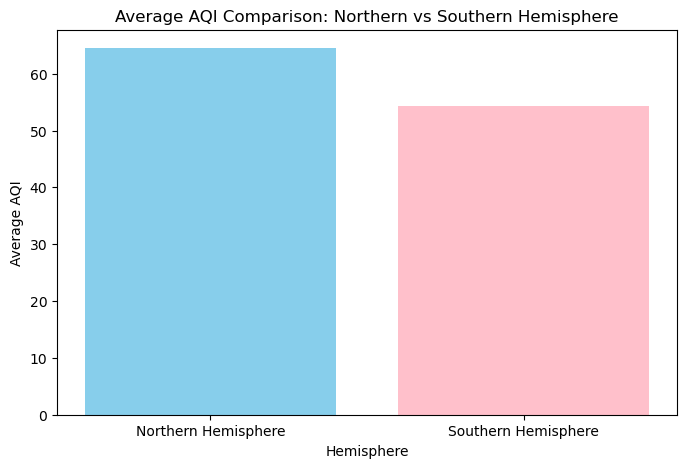

Average AQI in Northern Hemisphere: 64.51448264544186
Average AQI in Southern Hemisphere: 54.27473148671566


In [38]:
# Split the data into Northern and Southern Hemispheres
northern_hemisphere = cities_continents_merged[cities_continents_merged['Latitude'] > 0]
southern_hemisphere = cities_continents_merged[cities_continents_merged['Latitude'] < 0]

# Calculate average AQI for both hemispheres
avg_northern_hemisphere = northern_hemisphere['Air_Quality_Value'].mean()
avg_southern_hemisphere = southern_hemisphere['Air_Quality_Value'].mean()

# Plot the comparison
hemisphere_labels = ['Northern Hemisphere', 'Southern Hemisphere']
avg_aqi = [avg_northern_hemisphere, avg_southern_hemisphere]

plt.figure(figsize=(8, 5))
plt.bar(hemisphere_labels, avg_aqi, color=['skyblue', 'pink'])
plt.xlabel('Hemisphere')
plt.ylabel('Average AQI')
plt.title('Average AQI Comparison: Northern vs Southern Hemisphere')
plt.show()

# You can also print the results
print(f"Average AQI in Northern Hemisphere: {avg_northern_hemisphere}")
print(f"Average AQI in Southern Hemisphere: {avg_southern_hemisphere}")

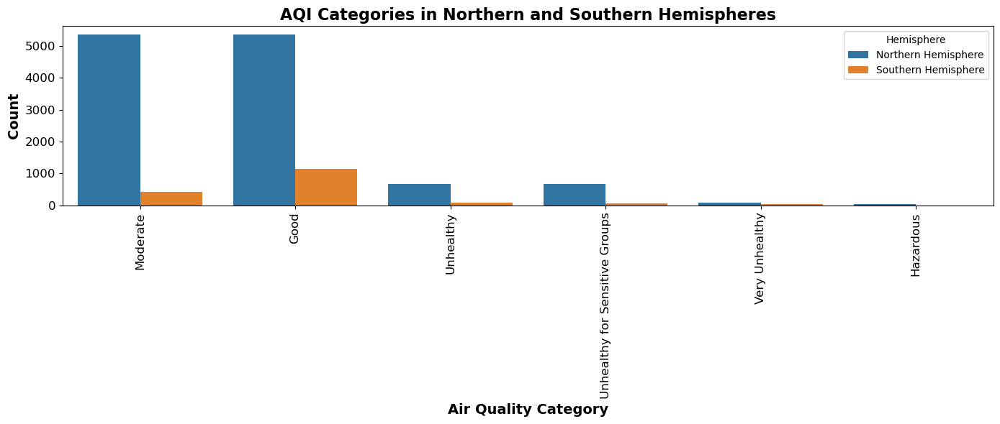

In [40]:
# Count the frequency of AQI categories for each hemisphere
northern_counts = northern_hemisphere['Air_Quality_Category'].value_counts()
southern_counts = southern_hemisphere['Air_Quality_Category'].value_counts()

# Create DataFrames to store the counts for each hemisphere
northern_df = northern_counts.reset_index()
northern_df.columns = ['Air_Quality_Category', 'Count']  # Renaming columns correctly
northern_df['Hemisphere'] = 'Northern Hemisphere'

southern_df = southern_counts.reset_index()
southern_df.columns = ['Air_Quality_Category', 'Count']  # Renaming columns correctly
southern_df['Hemisphere'] = 'Southern Hemisphere'

# Calculate the total count for each hemisphere
total_northern = northern_df['Count'].sum()  # Total count in Northern Hemisphere
total_southern = southern_df['Count'].sum()  # Total count in Southern Hemisphere

# Calculate the percentage for each AQI category in both hemispheres
northern_df['Percentage'] = (northern_df['Count'] / total_northern) * 100
southern_df['Percentage'] = (southern_df['Count'] / total_southern) * 100

# Combine both hemispheres' data into one DataFrame
combined_df = pd.concat([northern_df, southern_df])

# Define a color palette for the hemispheres
hemisphere_colors = {
    'Northern Hemisphere': '#1f77b4',  # Blue for Northern Hemisphere
    'Southern Hemisphere': '#ff7f0e'   # Orange for Southern Hemisphere
}

# Plot using seaborn's barplot, splitting by 'Hemisphere' and 'Air_Quality_Category'
plt.figure(figsize=(14, 6))

# Create a bar plot
sns.barplot(data=combined_df, x='Air_Quality_Category', y='Count', hue='Hemisphere', 
            palette=hemisphere_colors)

# Set the title and labels
plt.title('AQI Categories in Northern and Southern Hemispheres', fontsize=16, fontweight='bold')
plt.xlabel('Air Quality Category', fontsize=14, fontweight='bold')
plt.ylabel('Count', fontsize=14, fontweight='bold')

# Rotate x-axis labels for better readability
plt.xticks(rotation="vertical", fontsize=12)
plt.yticks(fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()



In [42]:
northern_df

,Air_Quality_Category,Count,Hemisphere,Percentage
0,Moderate,5356,Northern Hemisphere,43.948470
1,Good,5356,Northern Hemisphere,43.948470
2,Unhealthy,676,Northern Hemisphere,5.546894
3,Unhealthy for Sensitive Groups,667,Northern Hemisphere,5.473045
4,Very Unhealthy,88,Northern Hemisphere,0.722081
5,Hazardous,44,Northern Hemisphere,0.361040


In [44]:
southern_df

,Air_Quality_Category,Count,Hemisphere,Percentage
0,Good,1141,Southern Hemisphere,64.499717
1,Moderate,432,Southern Hemisphere,24.420577
2,Unhealthy,91,Southern Hemisphere,5.144149
3,Unhealthy for Sensitive Groups,68,Southern Hemisphere,3.843980
4,Very Unhealthy,32,Southern Hemisphere,1.808932
5,Hazardous,5,Southern Hemisphere,0.282646


In [46]:
from scipy.stats import skew

# Calculate the skewness of the 'Count' column
data_skewness = skew(northern_df['Count'])
print(f"Skewness of the data in northern hemisphere: {data_skewness}")

# Calculate the skewness of the 'Count' column
data_skewness = skew(southern_df['Count'])
print(f"Skewness of the data in southern hemisphere: {data_skewness}")

Skewness of the data in northern hemisphere: 0.6723684431029037
Skewness of the data in southern hemisphere: 1.3761480102245838


In [48]:
# Create a figure and axes for the plot
plt.figure(figsize=(10, 6))

# Plot histogram for Northern Hemisphere
sns.histplot(northern_hemisphere_df['Air_Quality_Value'], bins=500, color='blue', label='Northern Hemisphere', kde=True)

# Plot histogram for Southern Hemisphere
sns.histplot(southern_hemisphere_df['Air_Quality_Value'], bins=500, color='red', label='Southern Hemisphere', kde=True)

# Add labels, title, and legend
plt.title('Comparison of AQI Distributions: Northern vs Southern Hemisphere', fontsize=14)
plt.xlabel('AQI Value', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.legend(title='Hemisphere')

# Show plot
plt.tight_layout()
plt.show()

NameError: name 'northern_hemisphere_df' is not defined

<Figure size 1000x600 with 0 Axes>

In [50]:
# List of AQI categories
aqi_categories = ['Good', 'Moderate', 'Unhealthy', 'Unhealthy for Sensitive Groups', 'Very Unhealthy', 'Hazardous']

# Initialize a dictionary to store the counts of each AQI category for each pollutant
pollutant_categories_counts = {
    'CO_AQI_Category': {},
    'Ozone_AQI_Category': {},
    'NO2_AQI_Category': {},
    'PM2.5_AQI_Category': {}
}

# Loop through each pollutant column and calculate the counts for each AQI category
for pollutant in ['CO_AQI_Category', 'Ozone_AQI_Category', 'NO2_AQI_Category', 'PM2.5_AQI_Category']:
    # Count the occurrences of each AQI category for the current pollutant
    category_counts = cities_continents_merged[pollutant].value_counts()
    
    # Reindex to ensure all AQI categories are included, and fill missing categories with 0
    category_counts = category_counts.reindex(aqi_categories, fill_value=0)
    
    # Store the counts in the dictionary
    pollutant_categories_counts[pollutant] = category_counts

# Convert the dictionary into a DataFrame for better visualization
pollutant_counts_df = pd.DataFrame(pollutant_categories_counts)

# Display the result
pollutant_counts_df

,CO_AQI_Category,Ozone_AQI_Category,NO2_AQI_Category,PM2.5_AQI_Category
Good,13954,12899,13947,6689
Moderate,1,730,9,5648
Unhealthy,0,146,0,728
Unhealthy for Sensitive Groups,1,157,0,746
Very Unhealthy,0,24,0,102
Hazardous,0,0,0,43


<Figure size 1400x700 with 0 Axes>

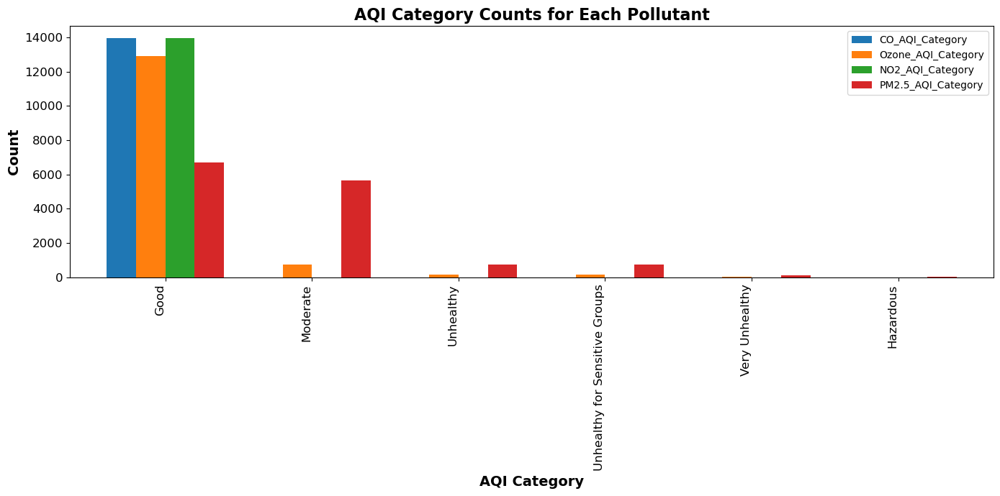

In [52]:
# Plotting the data as a bar plot
plt.figure(figsize=(14, 7))

# Plot each pollutant's AQI category counts
pollutant_counts_df.plot(kind='bar', figsize=(14, 7), width=0.8, stacked=False)

# Customizing the plot
plt.title('AQI Category Counts for Each Pollutant', fontsize=16, fontweight='bold')
plt.xlabel('AQI Category', fontsize=14, fontweight='bold')
plt.ylabel('Count', fontsize=14, fontweight='bold')
plt.xticks(ha='right', fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()

# Display the plot
plt.show()


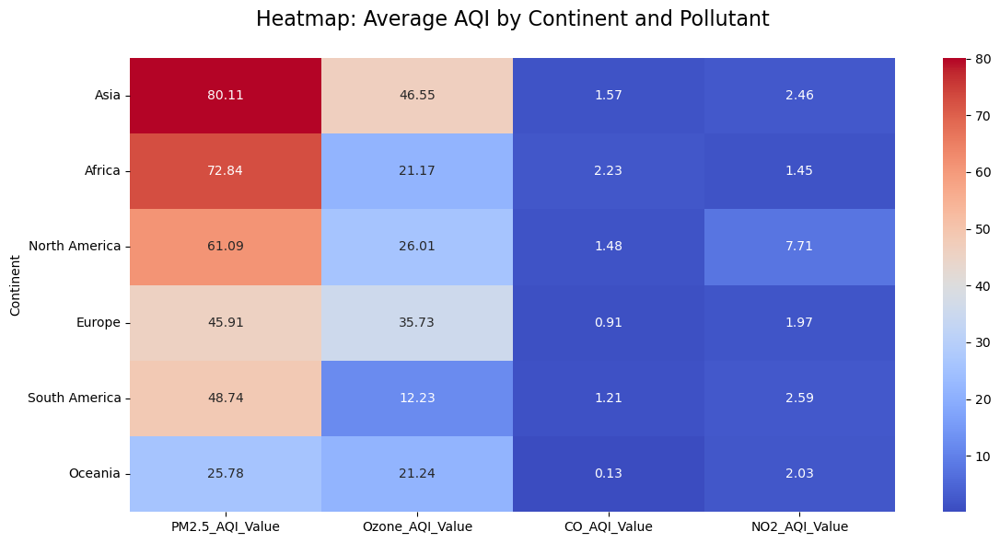

In [54]:
pollutants = ['PM2.5_AQI_Value','Ozone_AQI_Value', 'CO_AQI_Value', 'NO2_AQI_Value']

# Step 1: Calculate the average AQI values for each pollutant by continent
continent_data = cities_continents_merged.groupby('Continent')[pollutants].mean().reset_index()

# Step 2: Rank the continents by the average AQI across all pollutants
continent_data['Average_AQI'] = continent_data[pollutants].mean(axis=1)  # Calculate the mean AQI across pollutants
continent_data = continent_data.sort_values('Average_AQI', ascending=False)  # Sort by the average AQI

# Step 4: Create a heatmap to visualize the pollutants across continents
heatmap_data = continent_data[pollutants].set_index(continent_data['Continent'])

# Plot the heatmap
plt.figure(figsize=(12, 6))
sns.heatmap(heatmap_data, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Heatmap: Average AQI by Continent and Pollutant\n', fontsize =16)
plt.tight_layout()
plt.show()



In [56]:
continent_data

,Continent,PM2.5_AQI_Value,Ozone_AQI_Value,CO_AQI_Value,NO2_AQI_Value,Average_AQI
1,Asia,80.112613,46.547447,1.571471,2.458859,32.672598
0,Africa,72.840467,21.174125,2.229572,1.451362,24.423881
3,North America,61.091200,26.013112,1.476690,7.708916,24.072480
2,Europe,45.908995,35.732451,0.908575,1.973939,21.130990
5,South America,48.739164,12.226780,1.208204,2.591331,16.191370
4,Oceania,25.780702,21.236842,0.131579,2.026316,12.293860


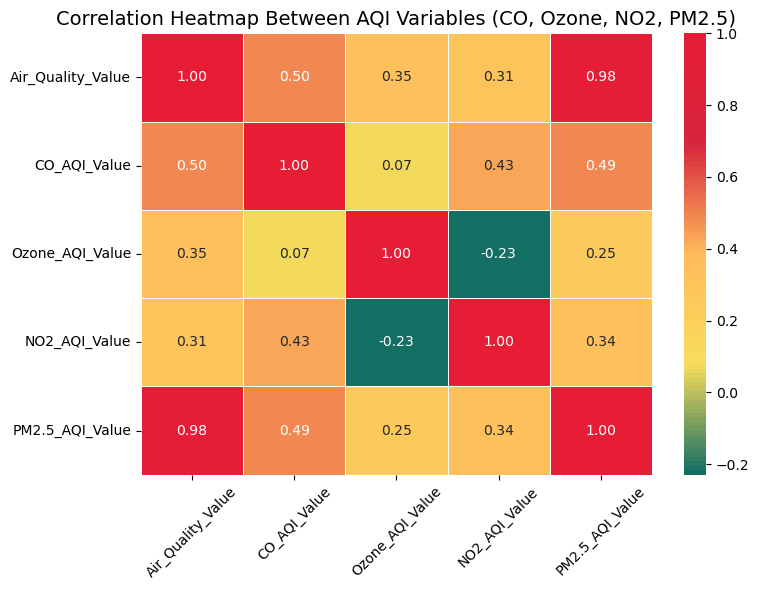

In [58]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

# Extract the relevant columns (AQI values for CO, Ozone, NO2, PM2.5, and overall AQI)
columns_of_interest = ['Air_Quality_Value', 'CO_AQI_Value', 'Ozone_AQI_Value', 'NO2_AQI_Value', 'PM2.5_AQI_Value']
data_for_corr = cities_continents_merged[columns_of_interest]

# 2. Calculate the Pearson correlation matrix
correlation_matrix = data_for_corr.corr()

# 3. Define a custom colormap (green, yellow, orange, red)
colors = ['#136F63', '#F9DC5C', '#FFBB5C', '#D7263D', '#E71D36'] # Define colors in order
custom_cmap = LinearSegmentedColormap.from_list("green_yellow_orange_red", colors, N=100)

# 4. Plot the heatmap with the custom colormap
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap=custom_cmap, fmt='.2f', linewidths=0.5)

# Title and labels
plt.title('Correlation Heatmap Between AQI Variables (CO, Ozone, NO2, PM2.5)', fontsize=14)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()

# Show the heatmap
plt.show()



In [60]:
correlation_matrix

,Air_Quality_Value,CO_AQI_Value,Ozone_AQI_Value,NO2_AQI_Value,PM2.5_AQI_Value
Air_Quality_Value,1.000000,0.495144,0.348281,0.308366,0.979874
CO_AQI_Value,0.495144,1.000000,0.074985,0.433509,0.493940
Ozone_AQI_Value,0.348281,0.074985,1.000000,-0.229369,0.252082
NO2_AQI_Value,0.308366,0.433509,-0.229369,1.000000,0.339855
PM2.5_AQI_Value,0.979874,0.493940,0.252082,0.339855,1.000000


In [62]:
category_counts = cities_continents_merged['Air_Quality_Category'].value_counts()
category_percentage = (category_counts / category_counts.sum()) * 100
category_table = pd.DataFrame({
    'Count': category_counts,
    'Percentage': category_percentage
})
category_table['Percentage'] = category_table['Percentage'].apply(lambda x: f"{x:.2f}%")
category_table

,Count,Percentage
Air_Quality_Category,,
Good,6497,46.55%
Moderate,5788,41.47%
Unhealthy,767,5.50%
Unhealthy for Sensitive Groups,735,5.27%
Very Unhealthy,120,0.86%
Hazardous,49,0.35%


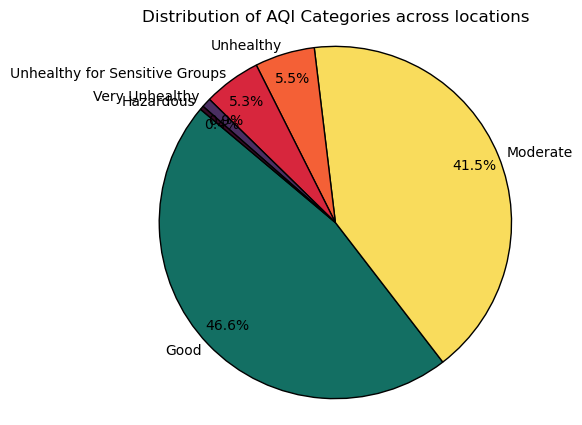

In [64]:
# 1. Group the data by 'AQI Category' and count the number of cities or countries in each category
category_counts = cities_continents_merged['Air_Quality_Category'].value_counts()
colors = ['#136F63', '#F9DC5C', '#F46036', '#D7263D', '#4A2E61', '#370926']
# 2. Plot the distribution of AQI Categories using a Pie chart
plt.figure(figsize=(5,5))
plt.pie(category_counts, 
        labels=category_counts.index, 
        autopct='%1.1f%%', 
        startangle=140, 
        colors=colors,
        pctdistance=0.85,  # Place the percentage labels closer to the center
        labeldistance=1.05,  # Move the labels away from the center
        wedgeprops={'edgecolor': 'black'})  # Add a border to wedges for better visibility

# Title and adjust aspect ratio for a more centered pie chart
plt.title('Distribution of AQI Categories across locations')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()



In [66]:
cities_continents_merged.City.nunique()

13956

In [68]:
# Filter the rows where AQI Category is "Unhealthy","Unhealthy for Sensitive Groups", "Very Unhealthy", or "Hazardous"
poor_air_quality = cities_continents_merged[cities_continents_merged['Air_Quality_Category'].isin(['Unhealthy','Unhealthy for Sensitive Groups', 'Very Unhealthy', 'Hazardous'])]

# Count the number of cities with poor air quality
num_poor_air_quality_cities = poor_air_quality['City'].nunique()

# Print the result
print(f"Number of cities with poor air quality: {num_poor_air_quality_cities}")


Number of cities with poor air quality: 1671


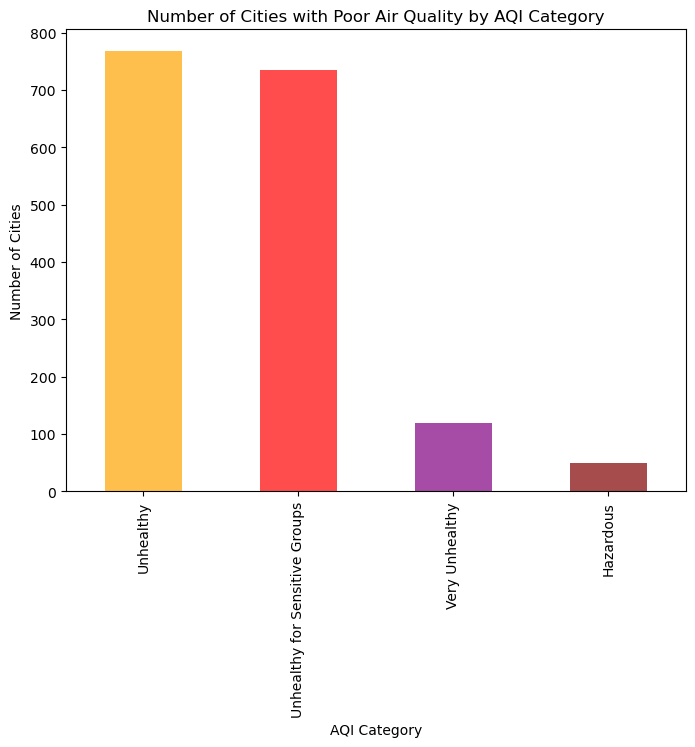

In [70]:
# Count how many cities fall into each AQI Category
category_counts = poor_air_quality['Air_Quality_Category'].value_counts()

# Plot a bar chart
plt.figure(figsize=(8, 6))
category_counts.plot(kind='bar', color=['orange', 'red', 'purple', 'maroon'], alpha=0.7)
plt.title('Number of Cities with Poor Air Quality by AQI Category')
plt.xlabel('AQI Category')
plt.ylabel('Number of Cities')
plt.xticks(rotation=90)
plt.show()


In [72]:
# Step 1: Group the data by 'Country' and calculate the required values (Q1, Q2, Q3, IQR)
country_stats = cities_continents_merged.groupby('Country')['Air_Quality_Value'].describe(percentiles=[.25, .5, .75]).reset_index()

# Extract Q1 (25th percentile), Q2 (50th percentile), and Q3 (75th percentile)
country_stats['Q1'] = country_stats['25%']
country_stats['Q2'] = country_stats['50%']
country_stats['Q3'] = country_stats['75%']

# Calculate the IQR
country_stats['IQR'] = country_stats['Q3'] - country_stats['Q1']

# Step 2: Calculate the outlier bounds for each country
country_stats['Lower Bound'] = country_stats['Q1'] - 1.5 * country_stats['IQR']
country_stats['Upper Bound'] = country_stats['Q3'] + 1.5 * country_stats['IQR']

# Step 3: Identify outliers in the main dataframe (cities_continents_merged)
outliers = cities_continents_merged[cities_continents_merged.apply(
    lambda x: x['Air_Quality_Value'] < country_stats.loc[country_stats['Country'] == x['Country'], 'Lower Bound'].values[0] or
              x['Air_Quality_Value'] > country_stats.loc[country_stats['Country'] == x['Country'], 'Upper Bound'].values[0], axis=1)]

# Step 4: Count the number of outliers per country
outlier_count = outliers['Country'].value_counts()

# Step 5: Create a DataFrame to display the results
outlier_data = pd.DataFrame({
    'Country': country_stats['Country'],
    'Q1': country_stats['Q1'],
    'Q2': country_stats['Q2'],
    'Q3': country_stats['Q3'],
    'IQR': country_stats['IQR'],
    'Lower Bound': country_stats['Lower Bound'],
    'Upper Bound': country_stats['Upper Bound'],
    'Outliers': country_stats['Country'].map(outlier_count).fillna(0)  # Fill missing values with 0 (countries without outliers)
})
outlier_data.sort_values(by ='Outliers', ascending = False).head(10)

,Country,Q1,Q2,Q3,IQR,Lower Bound,Upper Bound,Outliers
165,United States,46.00,55.0,67.00,21.00,14.500,98.500,157.0
22,Brazil,25.00,36.0,52.00,27.00,-15.500,92.500,48.0
128,Russia,34.00,39.0,47.00,13.00,14.500,66.500,29.0
68,India,77.75,150.0,170.00,92.25,-60.625,308.375,28.0
77,Japan,41.00,47.0,59.00,18.00,14.000,86.000,26.0
109,Netherlands,34.00,37.0,39.75,5.75,25.375,48.375,25.0
123,Philippines,44.50,54.0,70.50,26.00,5.500,109.500,17.0
74,Italy,48.00,59.0,71.00,23.00,13.500,105.500,16.0
53,France,38.00,50.0,61.00,23.00,3.500,95.500,16.0
116,Pakistan,159.00,173.0,187.75,28.75,115.875,230.875,16.0


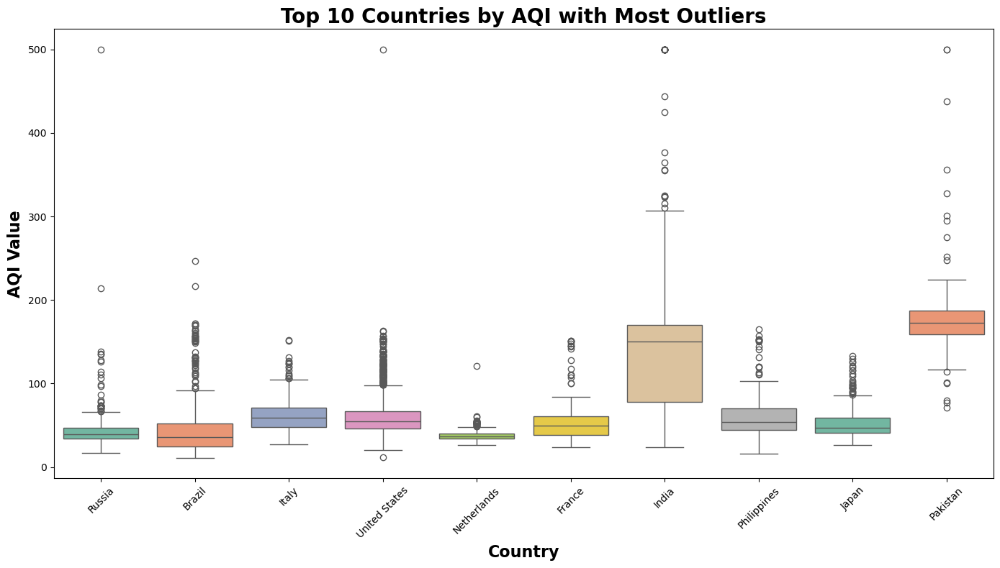

In [73]:
# Step 1: Identify countries with the most outliers
# Sort the 'outlier_data' DataFrame by the 'Outliers' column in descending order and select the top countries
top_outlier_countries = outlier_data.sort_values(by='Outliers', ascending=False).head(10)  # Adjust the number of countries as needed

# Step 2: Filter the original dataframe to only include cities from the top countries
filtered_df = cities_continents_merged[cities_continents_merged['Country'].isin(top_outlier_countries['Country'])]

# Step 3: Create the box plot for AQI distribution by Country, focusing on countries with the most outliers
plt.figure(figsize=(14, 8))
sns.boxplot(x='Country', y='Air_Quality_Value', data=filtered_df, hue = 'Country', palette="Set2")

# Rotate the x-axis labels for better readability
plt.xticks(rotation=45)

# Add title and labels
plt.title('Top 10 Countries by AQI with Most Outliers', fontsize=20, fontweight='bold')
plt.xlabel('Country', fontsize=16, fontweight='bold')
plt.ylabel('AQI Value', fontsize=16, fontweight='bold')

# Show the plot with tight layout
plt.tight_layout()
plt.show()

C:\Users\neela\AppData\Local\Temp\ipykernel_13112\3232886809.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=melted_data, x='Pollutant', y='AQI_Value', palette='Set2')


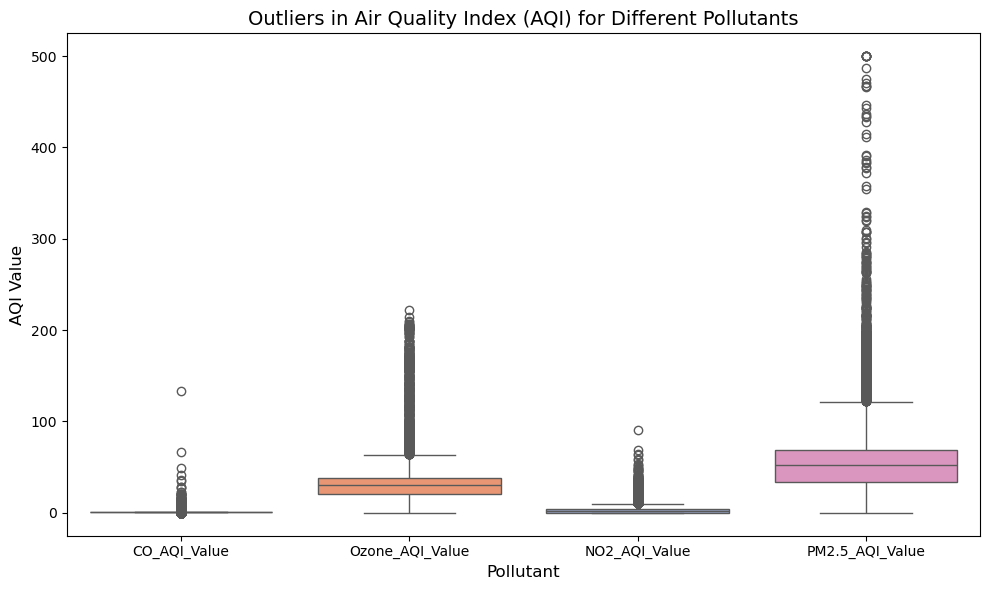

In [74]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Assuming your dataset is called 'cities_continents_merged'
# Select the pollutants for which you want to show outliers
pollutants = ['CO_AQI_Value', 'Ozone_AQI_Value', 'NO2_AQI_Value', 'PM2.5_AQI_Value']

# Create a DataFrame with the AQI values for each pollutant and their respective categories
melted_data = pd.melt(cities_continents_merged, id_vars=['Country', 'City', 'Continent'], 
                      value_vars=pollutants, 
                      var_name='Pollutant', value_name='AQI_Value')

# Plot the boxplot for all pollutants in one plot
plt.figure(figsize=(10, 6))
sns.boxplot(data=melted_data, x='Pollutant', y='AQI_Value', palette='Set2')

# Title and labels
plt.title('Outliers in Air Quality Index (AQI) for Different Pollutants', fontsize=14)
plt.xlabel('Pollutant', fontsize=12)
plt.ylabel('AQI Value', fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()


In [75]:
import pandas as pd

# Assuming your dataset is called 'cities_continents_merged'
# Select the pollutants for which you want to count outliers
pollutants = ['CO_AQI_Value', 'Ozone_AQI_Value', 'NO2_AQI_Value', 'PM2.5_AQI_Value']

# Initialize an empty dictionary to store the outlier counts
outlier_counts = {}

# Iterate over each pollutant to calculate the outliers
for pollutant in pollutants:
    # Calculate Q1, Q3, and IQR
    Q1 = cities_continents_merged[pollutant].quantile(0.25)
    Q3 = cities_continents_merged[pollutant].quantile(0.75)
    IQR = Q3 - Q1
    
    # Calculate the lower and upper bounds
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Identify the outliers (values below the lower bound or above the upper bound)
    outliers = cities_continents_merged[(cities_continents_merged[pollutant] < lower_bound) |
                                        (cities_continents_merged[pollutant] > upper_bound)]
    
    # Count the number of outliers for the current pollutant
    outlier_counts[pollutant] = outliers.shape[0]

# Convert the outlier counts to a DataFrame for better readability
outlier_count_df = pd.DataFrame(list(outlier_counts.items()), columns=['Pollutant', 'Outlier Count'])

# Display the outlier count for each pollutant
print(outlier_count_df)


         Pollutant  Outlier Count
0     CO_AQI_Value           4732
1  Ozone_AQI_Value            681
2    NO2_AQI_Value           1219
3  PM2.5_AQI_Value           1190


In [76]:
pollutants = ['CO_AQI_Value', 'Ozone_AQI_Value', 'NO2_AQI_Value', 'PM2.5_AQI_Value']

# Initialize an empty list to store the outlier counts
stats = []

for pollutant in pollutants:
    # Calculate Q1, Q2 (median), Q3
    Q1 = cities_continents_merged[pollutant].quantile(0.25)
    Q2 = cities_continents_merged[pollutant].quantile(0.5)
    Q3 = cities_continents_merged[pollutant].quantile(0.75)
    
    # Calculate IQR and determine outlier bounds
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Count outliers
    outliers = cities_continents_merged[(cities_continents_merged[pollutant] < lower_bound) | (cities_continents_merged[pollutant] > upper_bound)]
    outlier_count = outliers.shape[0]
    
    # Append results for this pollutant
    stats.append({
        'Pollutant': pollutant,
        'Q1': Q1,
        'Q2 (Median)': Q2,
        'Q3': Q3,
        'Outlier Count': outlier_count
    })

# Create a DataFrame with the results
outlier_stats_df = pd.DataFrame(stats)

# Display the resulting DataFrame
outlier_stats_df


,Pollutant,Q1,Q2 (Median),Q3,Outlier Count
0,CO_AQI_Value,1.0,1.0,1.0,4732
1,Ozone_AQI_Value,21.0,30.0,38.0,681
2,NO2_AQI_Value,0.0,2.0,4.0,1219
3,PM2.5_AQI_Value,34.0,52.0,69.0,1190


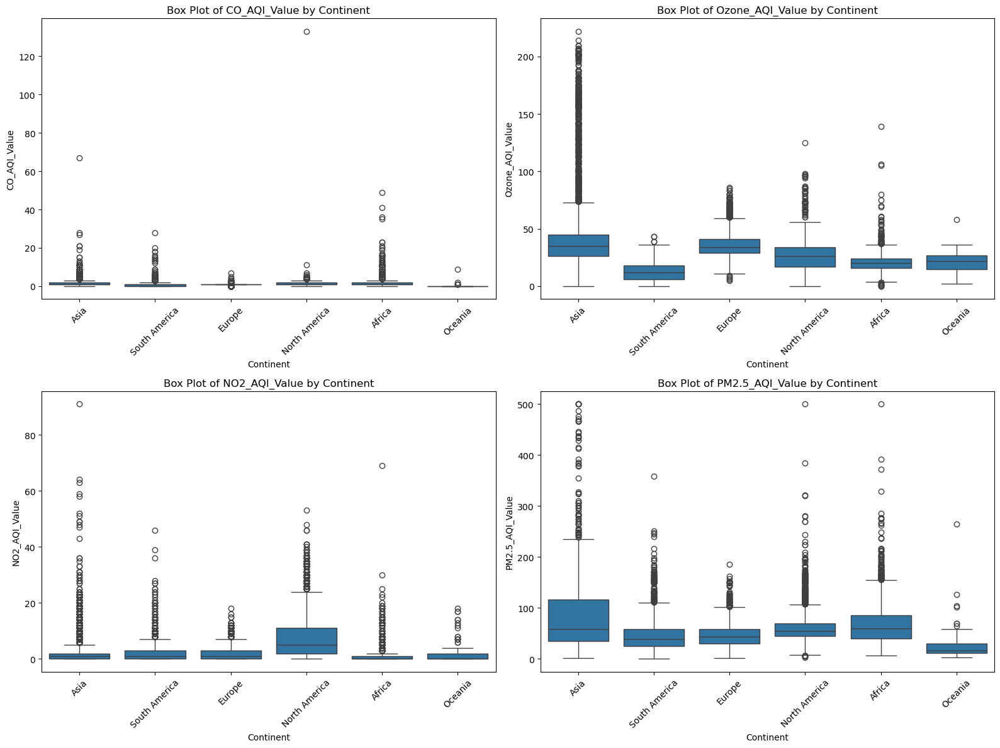

In [77]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'cities_continents_merged' is your DataFrame
# You should have a column called 'Continent' for this to work

# Pollutants to visualize
pollutants = ['CO_AQI_Value', 'Ozone_AQI_Value', 'NO2_AQI_Value', 'PM2.5_AQI_Value']

# Set up the figure
plt.figure(figsize=(16, 12))

# Plot box plots for each pollutant by continent
for idx, pollutant in enumerate(pollutants, 1):
    plt.subplot(2, 2, idx)  # 2x2 grid of plots
    sns.boxplot(data=cities_continents_merged, x='Continent', y=pollutant)
    plt.title(f'Box Plot of {pollutant} by Continent')
    plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

# Show the plot
plt.tight_layout()
plt.show()


In [78]:
import pandas as pd

# List of pollutants
pollutants = ['CO_AQI_Value', 'Ozone_AQI_Value', 'NO2_AQI_Value', 'PM2.5_AQI_Value']

# Initialize a dictionary to store DataFrames for each pollutant
pollutant_dfs = {}

# Iterate through each pollutant
for pollutant in pollutants:
    # Initialize an empty list to store summary statistics for each continent
    summary_data = []
    
    # Group by 'Continent' and calculate the required statistics for each continent
    for continent in cities_continents_merged['Continent'].unique():
        # Filter data for the specific continent and pollutant
        continent_data = cities_continents_merged[cities_continents_merged['Continent'] == continent]
        
        # Calculate Q1, Q2 (median), Q3 for the pollutant
        Q1 = continent_data[pollutant].quantile(0.25)
        Q2 = continent_data[pollutant].quantile(0.5)
        Q3 = continent_data[pollutant].quantile(0.75)
        
        # Calculate IQR and determine the outlier bounds
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        # Count the outliers (values outside the bounds)
        outliers = continent_data[(continent_data[pollutant] < lower_bound) | (continent_data[pollutant] > upper_bound)]
        outlier_count = outliers.shape[0]
        
        # Append the calculated statistics to the list
        summary_data.append({
            'Continent': continent,
            'Pollutant': pollutant,
            'Q1': Q1,
            'Q2 (Median)': Q2,
            'Q3': Q3,
            'Outlier Count': outlier_count
        })
    
    # Create a DataFrame for this pollutant and store it in the dictionary
    pollutant_dfs[pollutant] = pd.DataFrame(summary_data)

# Now, pollutant_dfs contains separate DataFrames for each pollutant
# For example, to view the CO_AQI_Value DataFrame:
pollutant_dfs['PM2.5_AQI_Value']



,Continent,Pollutant,Q1,Q2 (Median),Q3,Outlier Count
0,Asia,PM2.5_AQI_Value,35.00,58.0,116.00,63
1,South America,PM2.5_AQI_Value,25.00,39.0,59.00,91
2,Europe,PM2.5_AQI_Value,30.00,44.0,59.00,59
3,North America,PM2.5_AQI_Value,45.00,55.0,70.00,239
4,Africa,PM2.5_AQI_Value,40.00,60.0,86.00,88
5,Oceania,PM2.5_AQI_Value,11.25,17.0,30.25,7
6,NaN,PM2.5_AQI_Value,NaN,NaN,NaN,0


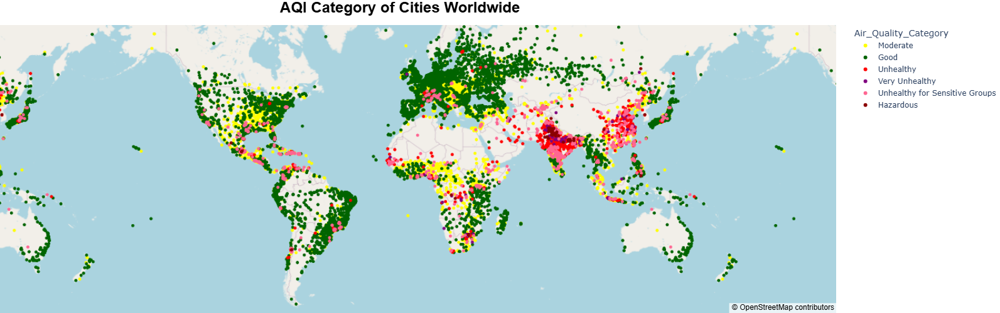

In [80]:
import plotly.express as px

# Define the color map for AQI categories
aqi_category_colors = {
    'Good': '#006400',  # Green for Good
    'Moderate': '#FFFF00',  # Yellow for Moderate
    'Unhealthy for Sensitive People': '#FFA500',  # Orange for Unhealthy for Sensitive People
    'Unhealthy': '#FF0000',  # Red for Unhealthy
    'Very Unhealthy': '#800080',  # Purple for Very Unhealthy
    'Hazardous': '#8B0000'  # Dark Red for Hazardous
}

# Use the entire cities_continents_merged dataframe
# Plotting the map for cities with AQI categories
fig = px.scatter_mapbox(
    cities_continents_merged, 
    lat = "Latitude", 
    lon = "Longitude", 
    color = "Air_Quality_Category",  # Color by AQI Category
    hover_name = "City", 
    hover_data = ["Air_Quality_Category", "Air_Quality_Value", "Latitude", "Longitude", "Country", "City", "Continent"],
    title = "AQI Category of Cities Worldwide",  # Title for the plot
    color_discrete_map = aqi_category_colors  # Use the color map for AQI categories
)

# Adjust layout and map style
fig.update_layout(
    title={
        'text': "AQI Category of Cities Worldwide",
        'font': {
            'size': 24,  # Set the font size
            'family': 'Arial, sans-serif',  # Set the font family
            'color': 'black',  # Set the font color
            'weight': 'bold',# Make the title bold
        },
        'x': 0.4,  # Center-align the title
        'xanchor': 'center'  # Make sure the title is anchored at the center
    },
    mapbox_style = "open-street-map",  # Map style (you can also try other styles like 'open-street-map')
    mapbox_zoom = 1,  # Adjust zoom level (you can fine-tune this for global view)
    mapbox_center = {"lat": 10, "lon": 0},  # Adjust map center (set to 0,0 for a global view)
    height =500,  # Height of the map
    margin = {"r": 0, "t": 40, "l": 0, "b": 0}  # Margins around the map
)

# Show the plot
fig.show()


In [82]:
import folium
from folium.plugins import MarkerCluster

# Define the color map for AQI categories
aqi_category_colors = {
    'Good': '#006400',  # Green for Good
    'Moderate': '#FFFF00',  # Yellow for Moderate
    'Unhealthy for Sensitive People': '#FFA500',  # Orange for Unhealthy for Sensitive People
    'Unhealthy': '#FF0000',  # Red for Unhealthy
    'Very Unhealthy': '#800080',  # Purple for Very Unhealthy
    'Hazardous': '#8B0000'  # Dark Red for Hazardous
}

# Initialize the map centered at a global view
m = folium.Map(location=[10, 0], zoom_start=1, tiles='OpenStreetMap')

# Create a marker cluster to group markers
marker_cluster = MarkerCluster().add_to(m)

# Iterate over cities in your dataframe and add circle markers for each
for _, row in cities_continents_merged.iterrows():
    # Get the color for the AQI category
    aqi_category = row['Air_Quality_Category']
    color = aqi_category_colors.get(aqi_category, '#808080')  # Default to grey if AQI category is not in the color map

    # Create the CircleMarker for each city
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=7,  # Size of the circle marker
        color=color,  # Set the color based on the AQI category
        fill=True,
        fill_color=color,  # Fill the circle with the same color
        fill_opacity=0.7,  # Opacity of the filled color
        popup=f"City: {row['City']}<br>AQI Category: {aqi_category}<br>AQI Value: {row['Air_Quality_Value']}<br>Country: {row['Country']}<br>Continent: {row['Continent']}<br>Latitude: {row['Latitude']}<br>Longitude: {row['Longitude']}",
        tooltip=(
            f"City: {row['City']}<br>"
            f"AQI Category: {aqi_category}<br>"
            f"AQI Value: {row['Air_Quality_Value']}<br>"
            f"Country: {row['Country']}<br>"
            f"Continent: {row['Continent']}"
        ),  # Tooltip with hover data
    ).add_to(marker_cluster)

# Add a title (optional, Folium does not support titles natively, so you can add a custom one via HTML)
title_html = '''
             <h3 align="center" style="font-size:24px"><b>AQI Category of Cities Worldwide</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))

# Show the map
m.save("aqi_category_map.html")  # Save the map as an HTML file
m 

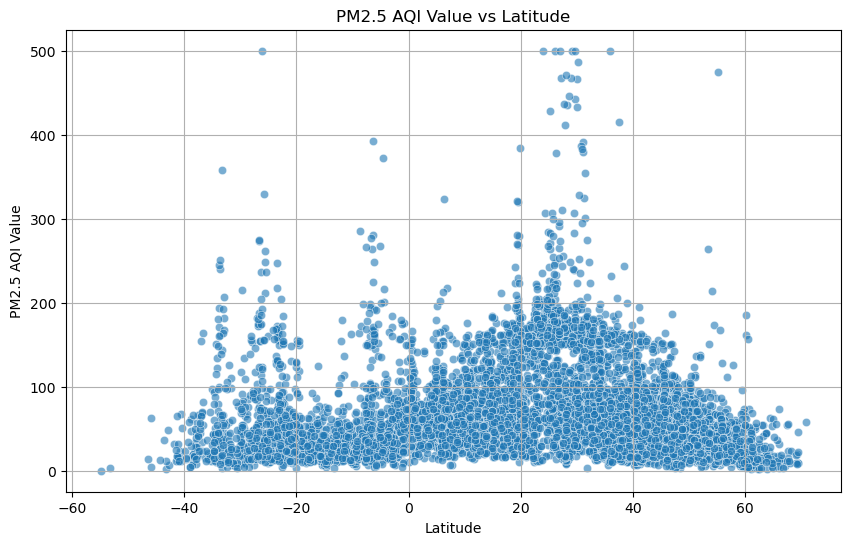

In [89]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Latitude', y='PM2.5_AQI_Value', data=cities_continents_merged, alpha=0.6)
plt.title('PM2.5 AQI Value vs Latitude')
plt.xlabel('Latitude')
plt.ylabel('PM2.5 AQI Value')
plt.grid(True)
plt.show()


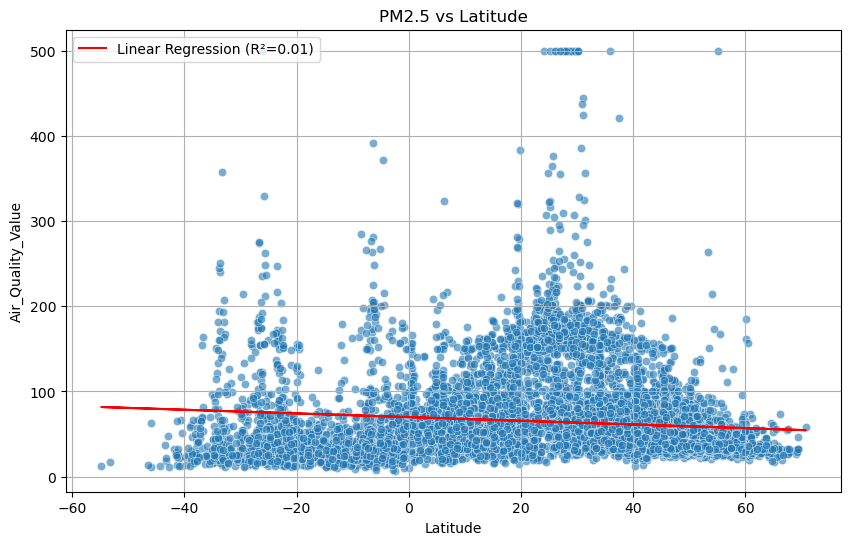

Linear Regression Equation: y = -0.22x + 69.92
R-squared: 0.01


In [101]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import linregress

# Create a scatter plot
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Latitude', y='Air_Quality_Value', data=cities_continents_merged, alpha=0.6)

# Perform linear regression using scipy's linregress
slope, intercept, r_value, p_value, std_err = linregress(cities_continents_merged['Latitude'], cities_continents_merged['Air_Quality_Value'])

# Plot the regression line
plt.plot(cities_continents_merged['Latitude'], slope * cities_continents_merged['Latitude'] + intercept, color='red', label=f'Linear Regression (R²={r_value**2:.2f})')

# Set plot titles and labels
plt.title('PM2.5 vs Latitude')
plt.xlabel('Latitude')
plt.ylabel('Air_Quality_Value')
plt.grid(True)

# Show the legend
plt.legend()

# Show the plot
plt.show()

# Print the regression results
print(f"Linear Regression Equation: y = {slope:.2f}x + {intercept:.2f}")
print(f"R-squared: {r_value**2:.2f}")


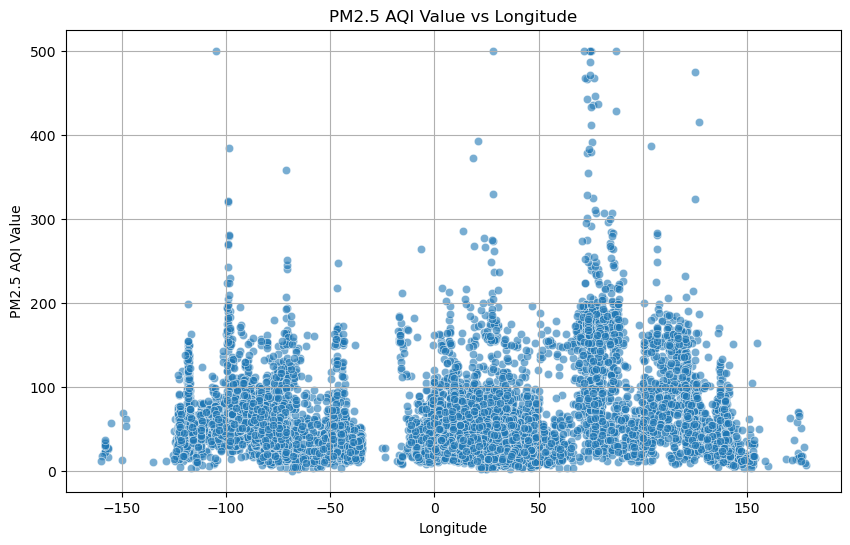

In [90]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Longitude', y='PM2.5_AQI_Value', data=cities_continents_merged, alpha=0.6)
plt.title('PM2.5 AQI Value vs Longitude')
plt.xlabel('Longitude')
plt.ylabel('PM2.5 AQI Value')
plt.grid(True)
plt.show()